# **Product Recognition of Books**

## Image Processing and Computer Vision - Assignment Module \#1


Contacts:

- Prof. Giuseppe Lisanti -> giuseppe.lisanti@unibo.it
- Prof. Samuele Salti -> samuele.salti@unibo.it
- Alex Costanzino -> alex.costanzino@unibo.it
- Francesco Ballerini -> francesco.ballerini4@unibo.it

Computer vision-based object detection techniques can be applied in library or bookstore settings to build a system that identifies books on shelves.

Such a system could assist in:
* Helping visually impaired users locate books by title/author;
* Automating inventory management (e.g., detecting misplaced or out-of-stock books);
* Enabling faster book retrieval by recognizing spine text or cover designs.

## Task
Develop a computer vision system that, given a reference image for each book, is able to identify such book from one picture of a shelf.

<figure>
<a href="https://ibb.co/pvLVjbM5"><img src="https://i.ibb.co/svVx9bNz/example.png" alt="example" border="0"></a>
</figure>

For each type of product displayed on the shelf, the system should compute a bounding box aligned with the book spine or cover and report:
1. Number of instances;
1. Dimension of each instance (area in pixel of the bounding box that encloses each one of them);
1. Position in the image reference system of each instance (four corners of the bounding box that enclose them);
1. Overlay of the bounding boxes on the scene images.

<font color="red"><b>Each step of this assignment must be solved using traditional computer vision techniques.</b></font>

#### Example of expected output
```
Book 0 - 2 instance(s) found:
  Instance 1 {top_left: (100,200), top_right: (110, 220), bottom_left: (10, 202), bottom_right: (10, 208), area: 230px}
  Instance 2 {top_left: (90,310), top_right: (95, 340), bottom_left: (24, 205), bottom_right: (23, 234), area: 205px}
Book 1 – 1 instance(s) found:
.
.
.
```

## Data
Two folders of images are provided:
* **Models**: contains one reference image for each product that the system should be able to identify;
* **Scenes**: contains different shelve pictures to test the developed algorithm in different scenarios.

from google.colab import drive
drive.mount('/content/drive')

!cp -r /content/drive/MyDrive/AssignmentsIPCV/dataset.zip ./
!unzip dataset.zip

## Evaluation criteria
1. **Clarity and conciseness**. Present your work in a readable way: format your code and comment every important step;

2. **Procedural correctness**. There are several ways to solve the assignment. Design your own sound approach and justify every decision you make;

3. **Correctness of results**. Try to solve as many instances as possible. You should be able to solve all the instances of the assignment, however, a thoroughly justified and sound procedure with a lower number of solved instances will be valued **more** than a poorly designed and justified approach that solves more or all instances.

## Util function and Data Loading

In [391]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import math

In [392]:
root_path = "/Users/leonardomassaro/Desktop/dataset_books/"

In [393]:
scenes_paths = [root_path + f"scenes/scene_{i}.jpg" for i in range(29)]
model_paths = [root_path + f"models/model_{i}.png" for i in range(22)]

scenes = [cv2.imread(path) for path in scenes_paths]
scenes_grayscale = [cv2.cvtColor(scene, cv2.COLOR_BGR2GRAY) for scene in scenes]
models = [cv2.imread(path) for path in model_paths]
models_grayscale = [cv2.cvtColor(model, cv2.COLOR_BGR2GRAY) for model in models]

In [394]:

def display_image_grid(images, total_size=(10, 10), ncols=None, show_axes=False):
    """
    Display a grid of images using matplotlib, preserving aspect ratios.

    Parameters
    ----------
    images : list
        List of image arrays (e.g., from PIL.Image or matplotlib.image.imread()).
    total_size : tuple (width, height)
        Total size of the display area in inches (figure size).
    ncols : int, optional
        Number of columns. If None, it is automatically chosen to form a near-square grid.
    show_axes : bool
        Whether to display axes ticks and labels.
    """
    num_images = len(images)
    if num_images == 0:
        raise ValueError("The image list is empty.")

    # Auto-determine number of columns and rows
    if ncols is None:
        ncols = math.ceil(math.sqrt(num_images))
    nrows = math.ceil(num_images / ncols)

    # Create figure
    fig, axes = plt.subplots(nrows, ncols, figsize=total_size,
                             constrained_layout=True)

    # Flatten axes array for easy iteration
    if isinstance(axes, plt.Axes):
        axes = [axes]
    else:
        axes = axes.flatten()

    for i, ax in enumerate(axes):
        if i < num_images:
            img = images[i]
            ax.imshow(img, aspect='equal', cmap='gray')  # Preserve each image's aspect ratio
            if not show_axes:
                ax.axis('off')
        else:
            ax.axis('off')  # Hide unused subplots

    plt.show()

## Remove borders from model images:
Done to consider only the core of the informations contained in book titles and figures

In [395]:
def cut_out_borders(image, percentage:int):
    '''
    Cut out border portions of the image

    Parameters
    ----------
    image: image to crop
    percentage: portion to be cut out from each side of the image (top, right, bottom, left)
    '''
    if percentage >= 50:
        raise Exception("Percentage must be lower than 50%")
    cut_x, cut_y = int((image.shape[0]/100)*percentage), int((image.shape[1]/100)*percentage)
    return image[cut_x:-cut_x-1, cut_y:-cut_y-1]
    
def pad_borders(image, percentage, value_pxls=0):
    height, width  = image.shape[0], image.shape[1]
    border_y, border_x = int((image.shape[0]/100)*percentage), int((image.shape[1]/100)*percentage)
    print("x:", width, "y:", height)
    big_picture = np.ones(shape=(height+(2*border_y), width+(2*border_x)), dtype=np.uint8) * value_pxls
    big_picture[ border_y-1:-border_y-1, border_x-1:-border_x-1] = image
    return big_picture    

## Edges detection calibrated on scenes

In [396]:
def edge_det_scenes(image):
    normalized = cv2.equalizeHist(image)
    edges = cv2.Canny(normalized, threshold1=50, threshold2=200)
    return edges


In [397]:
def hough_detection(edges_image):
    lines = cv2.HoughLinesP(
            edges_image, # Input edge image
            2, # Distance resolution in pixels
            np.pi/500, # Angle resolution in radians
            threshold=200, # Min number of votes for valid line
            minLineLength=3, # Min allowed length of line
            maxLineGap=5 # Max allowed gap between line for joining them
            )
    lines_list = []
    lines_image = edges_image - edges_image
    for points in lines:
        # Extracted points nested in the list
        x1,y1,x2,y2=points[0]
        # Draw the lines joing the points
        # On the original image
        cv2.line(lines_image,(x1,y1),(x2,y2),200,1)
        # Maintain a simples lookup list for points
        lines_list.append([(x1,y1),(x2,y2)])
    return lines_image
    

In [398]:
def edge_det_models(image):
    normalized = cv2.equalizeHist(image)
    #blur = cv2.GaussianBlur(normalized, (7,7), 2)
    edges = cv2.Canny(normalized, threshold1=30, threshold2=200)
    #contours, hierarchy = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)
    #final = cv2.drawContours(edges, contours, -1, 180, 2)
    return edges


## Edge on RGBs

In [399]:
def edge_on_rgb(image_bgr):
    b, g, r = cv2.split(image_bgr)
    b_norm, g_norm, r_norm = cv2.equalizeHist(b), cv2.equalizeHist(g),cv2.equalizeHist(r),
    gaussian_kernel, std_dev = (3,3), 2
    threshold1, threshold2 = 10, 40
    edges_b = cv2.Canny(cv2.GaussianBlur(b_norm, gaussian_kernel, std_dev), threshold1, threshold2)
    edges_g = cv2.Canny(cv2.GaussianBlur(g_norm, gaussian_kernel, std_dev), threshold1, threshold2)
    edges_r = cv2.Canny(cv2.GaussianBlur(r_norm, gaussian_kernel, std_dev), threshold1, threshold2)

    # Combine the results
    #edges_intersection = cv2.bitwise_and(edges_b, cv2.bitwise_and(edges_g, edges_r))
    edges_union = cv2.bitwise_or(edges_b, cv2.bitwise_or(edges_g, edges_r))
    return edges_union

In [400]:
def expand_edges_scenes(edge_image):
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (3,3))
    closed = cv2.morphologyEx(edge_image, cv2.MORPH_CLOSE, kernel)
    return closed

In [401]:
def fit_rectangle_model(image):
    image = pad_borders(image, 10)
    # 2. Morphological closing to clean up thin gaps
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (7,7))
    closed = cv2.morphologyEx(image, cv2.MORPH_CLOSE, kernel)

    display_image_grid([closed])
    # 3. Find all contours
    contours, _ = cv2.findContours(closed, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

    # 4. Select the best "inner" rectangular contour
    # We’ll use hierarchy info from RETR_TREE (parent/child relationships)
    best = None
    best_area = 0

    for i, c in enumerate(contours):
        area = cv2.contourArea(c)
        if area < 1500:  # skip tiny noise
            continue

        # Fit a minimum-area rectangle
        rect = cv2.minAreaRect(c)
        (x, y), (w, h), angle = rect

        # Skip outer contours by comparing bounding box to image size
        if (w * h > 0.9 * image.shape[0] * image.shape[1]) or (w * h < 0.6 * image.shape[0] * image.shape[1]):
            continue

        # Optional: require roughly rectangular shape (aspect ratio constraint)
        #aspect = max(w, h) / min(w, h)
        #if aspect < 1.5 or aspect > 10:
            #continue

        if area > best_area:
            best = rect
            best_area = area

    # 5. Draw the best inner rectangle
    result = image.copy()
    if best is not None:
        box = cv2.boxPoints(best)
        box = np.int64(box)
        cv2.drawContours(result, [box], 0, 255, 3)
    return result
    

In [402]:
def filter_blobs(image_edges):
    contours, _ = cv2.findContours(image_edges, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    filtered = []
    for c in contours:
        area = cv2.contourArea(c)

        # Compute contour bounding box
        x, y, w, h = cv2.boundingRect(c)

        # Compute aspect ratio and extent
        aspect_ratio = max(w, h) / (min(w, h) + 1e-5)
        extent = area / (w * h + 1e-5)  # how much of bounding box is filled

        # Filter criteria for "line-like" shapes:
        # - long and thin (high aspect ratio)
        # - small fill ratio (extent < 0.3)
        # - not too tiny
        if aspect_ratio > 6 and extent < 0.8:
            filtered.append(c)
    debug = image_edges - image_edges
    cv2.drawContours(debug, filtered, -1, 255, 2)
    return debug
    

In [403]:

def extract_connected_regions(image, points, connectivity=4):
    """
    Given an edge-detected image and a list of seed points,
    returns a mask for each connected region that shares the same color
    as the seed point (using flood fill or connected components).

    Args:
        image (np.ndarray): Input image (grayscale or binary).
        points (list of tuples): List of (x, y) seed points.
        connectivity (int): 4 or 8 connectivity for region growing.

    Returns:
        regions (list of np.ndarray): List of binary masks, one per point.
    """

    h, w = image.shape
    tot_mask = image - image

    # Keep track of processed pixels to avoid overlaps
    processed = np.zeros_like(image, dtype=np.uint8)

    for i, (x, y) in enumerate(points):
        if x < 0 or y < 0 or x >= w or y >= h:
            print(f"Skipping invalid point {x, y}")
            continue

        target_value = image[y, x]

        #if it is on the edge do not consider
        if target_value != 0: 
            continue
        # Skip if already processed
        if processed[y, x]:
            continue

        # Flood fill to get connected region
        mask = np.zeros((h + 2, w + 2), np.uint8)
        _, _, _, rect = cv2.floodFill(
            image.copy(), mask, (x, y),
            newVal=255,
            loDiff=0, upDiff=0,
            flags=connectivity | (255 << 8)
        )

        # Flood-filled mask (remove 1px border added by OpenCV)
        region_mask = (mask[1:-1, 1:-1] > 0).astype(np.uint8)

        # Update processed
        processed = cv2.bitwise_or(processed, region_mask)

        tot_mask = cv2.bitwise_or(tot_mask, region_mask)

    return tot_mask

In [404]:
def get_min_area_bounding_box(mask, min_area=0):
    mask = (mask > 0).astype(np.uint8)

    # Find contours
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if not contours:
        return None, None

    # Combine all contours to get the overall region
    cnt = np.vstack(contours)

    # Get min-area rectangle
    rect = cv2.minAreaRect(cnt)
    (cx, cy), (w, h), angle = rect
    (cx, cy), (w, h), angle = (cx, cy), (w, h), angle

    box_area = w * h
    if box_area < min_area and box_area > 0:
        scale = (min_area / box_area) ** 0.5
        w *= scale
        h *= scale
        rect = ((cx, cy), (w, h), angle)

    # Convert to 4 corner points
    box_points = cv2.boxPoints(rect)
    box_points = np.int64(box_points)

    return box_points, rect

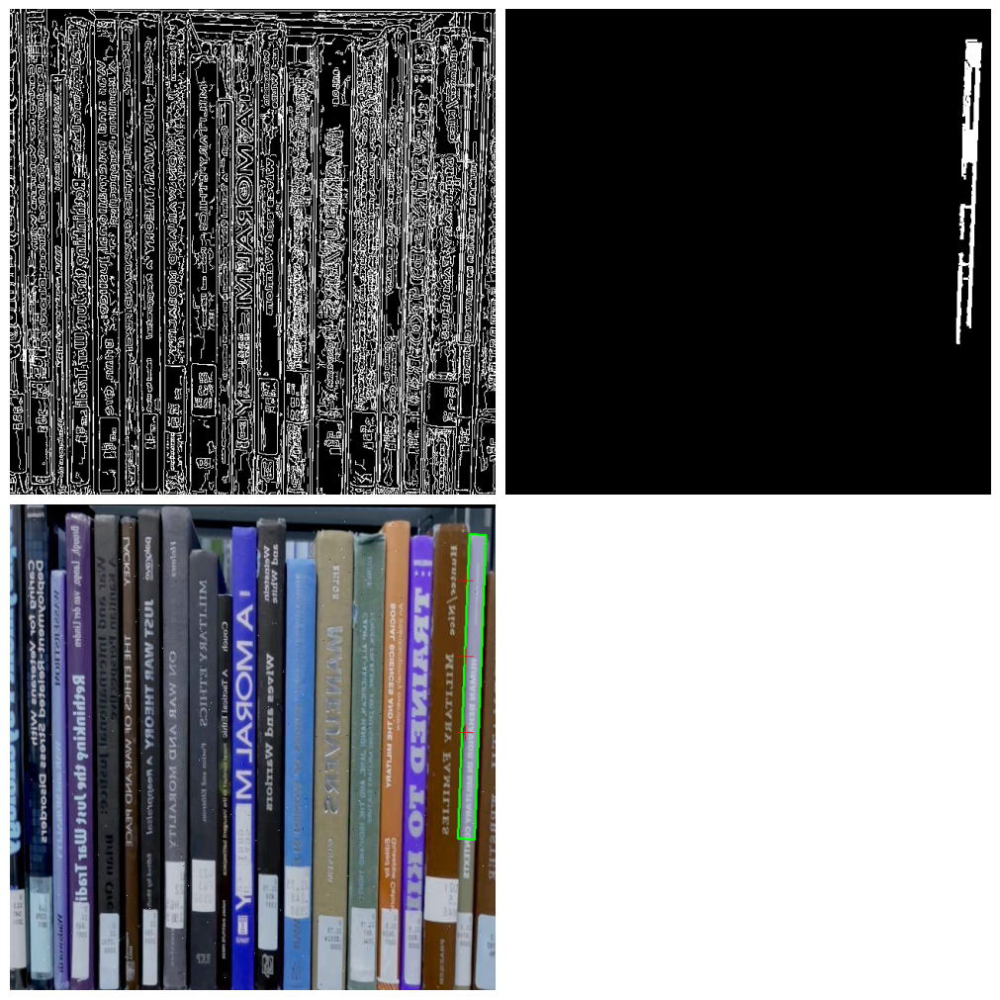

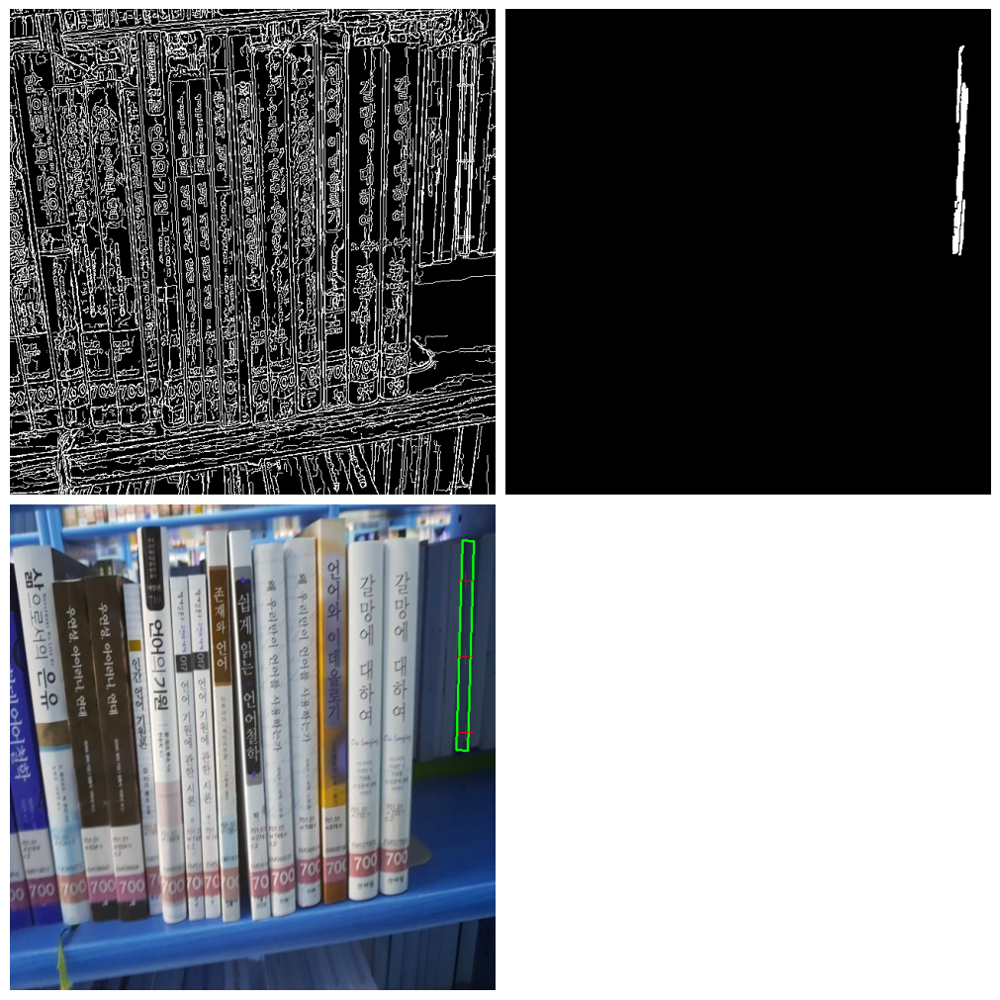

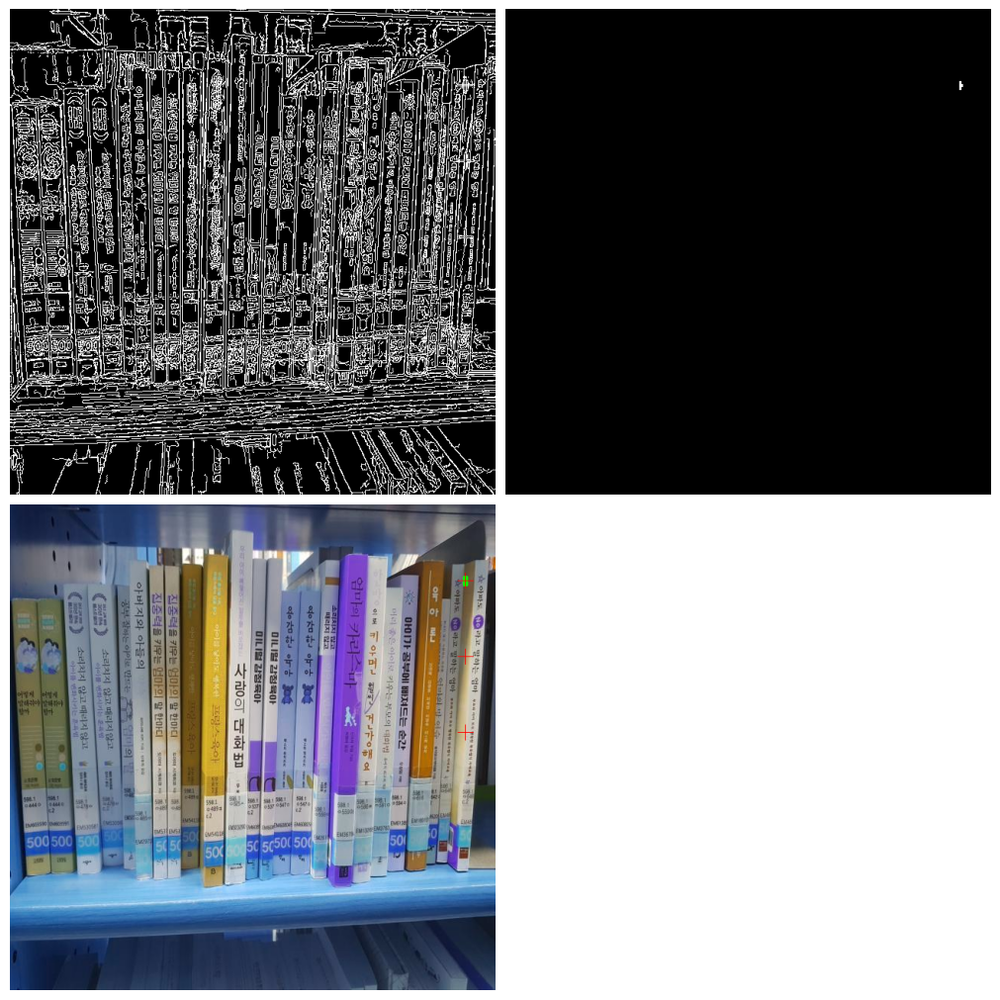

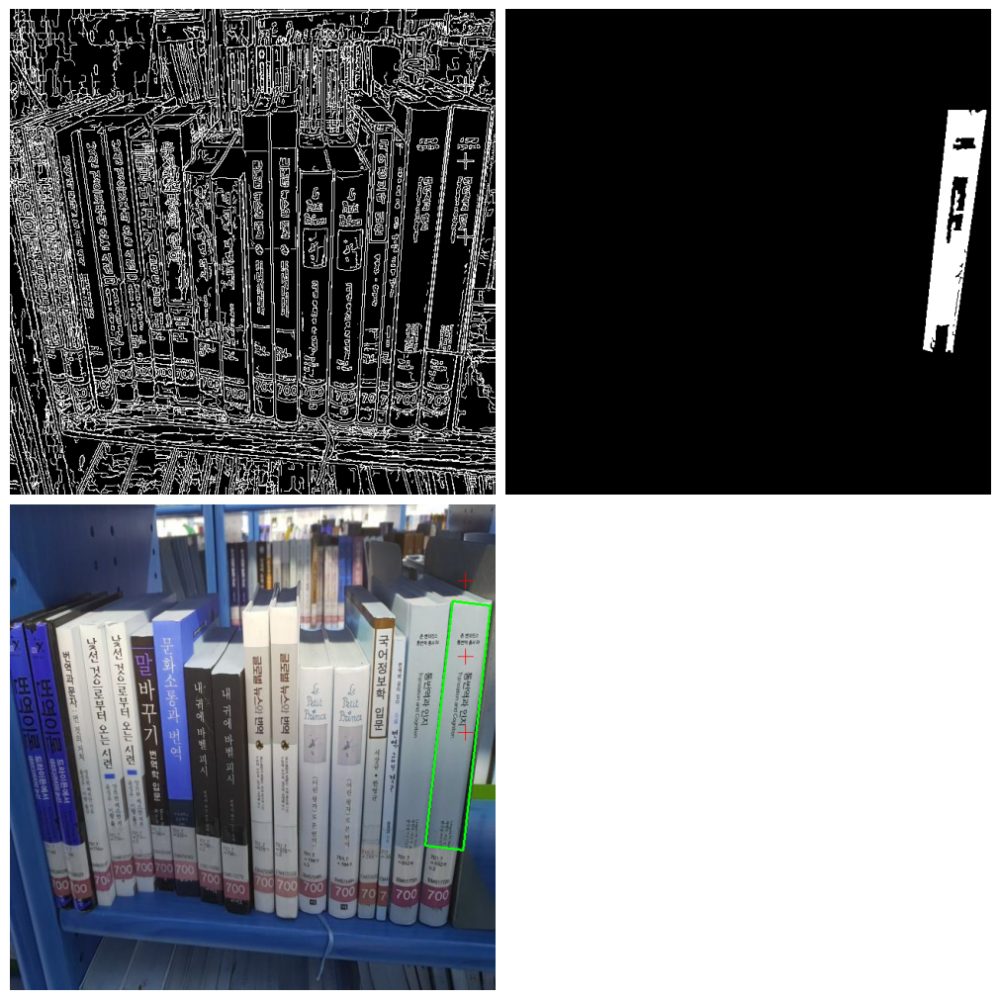

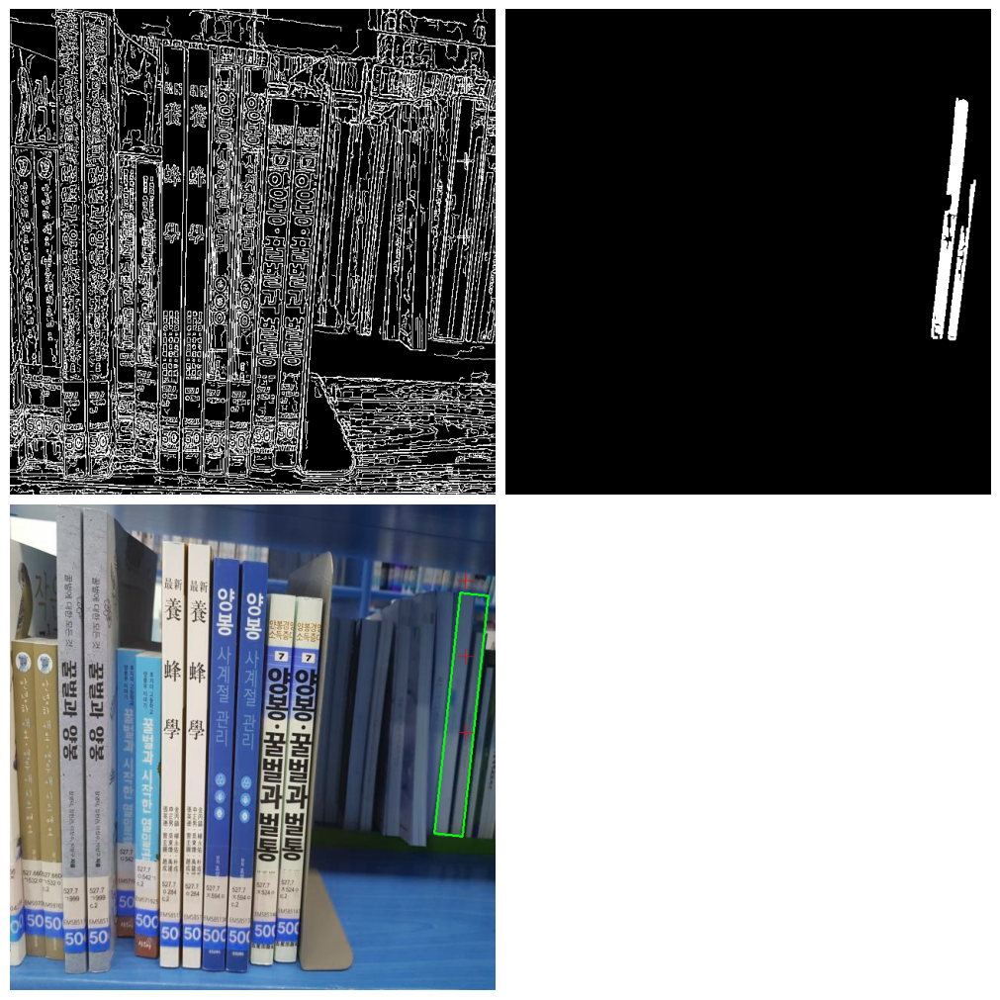

...

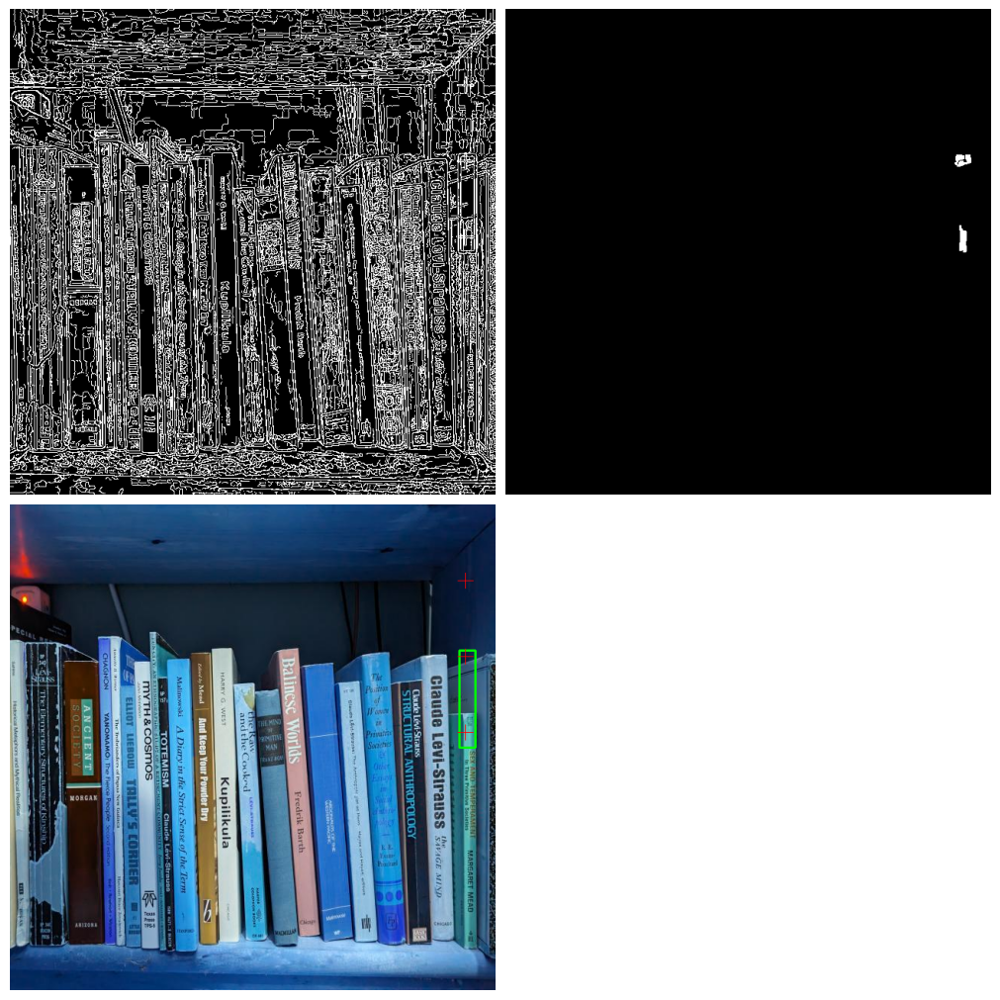

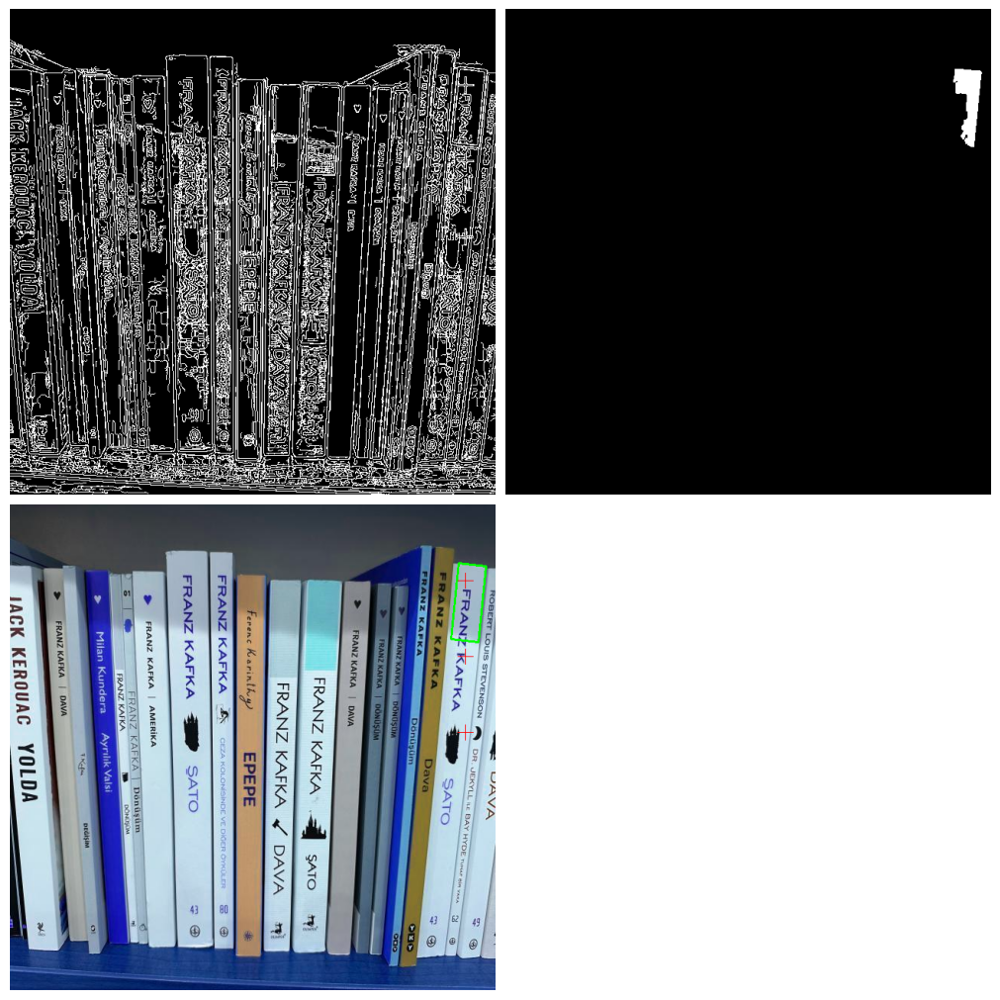

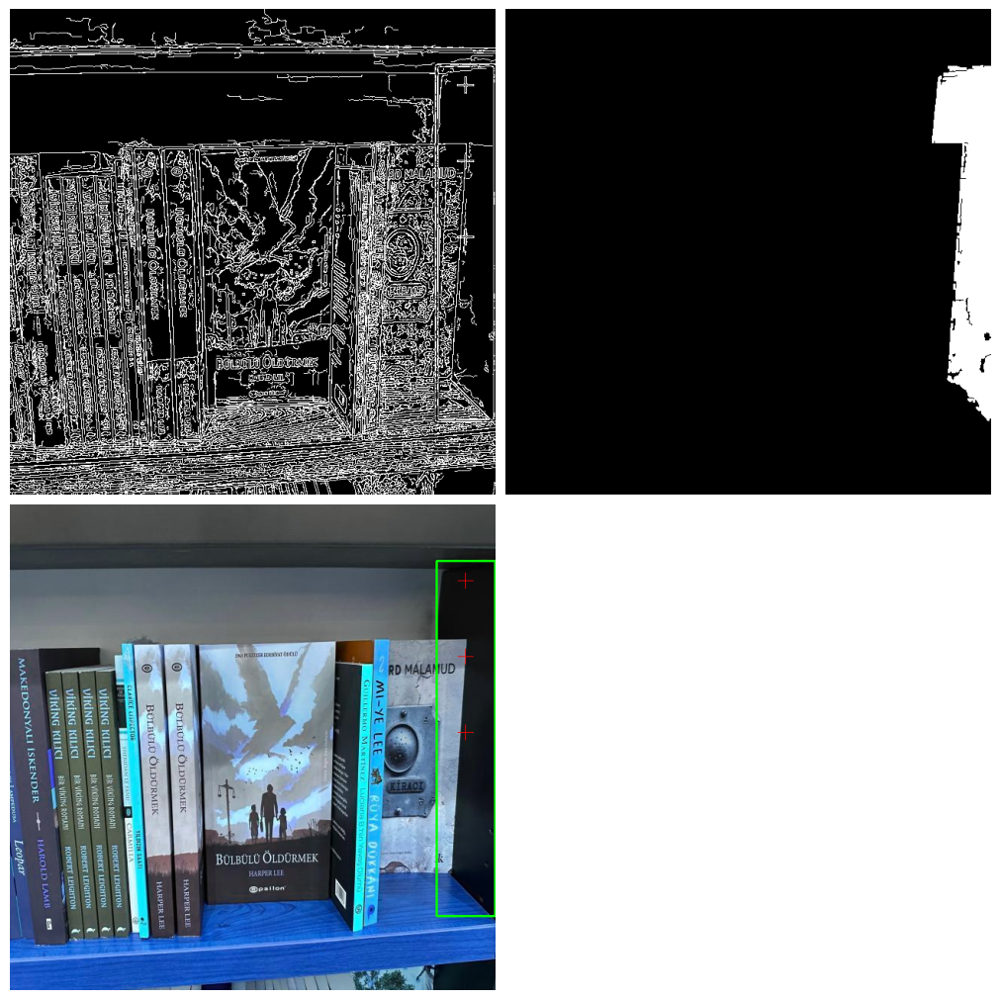

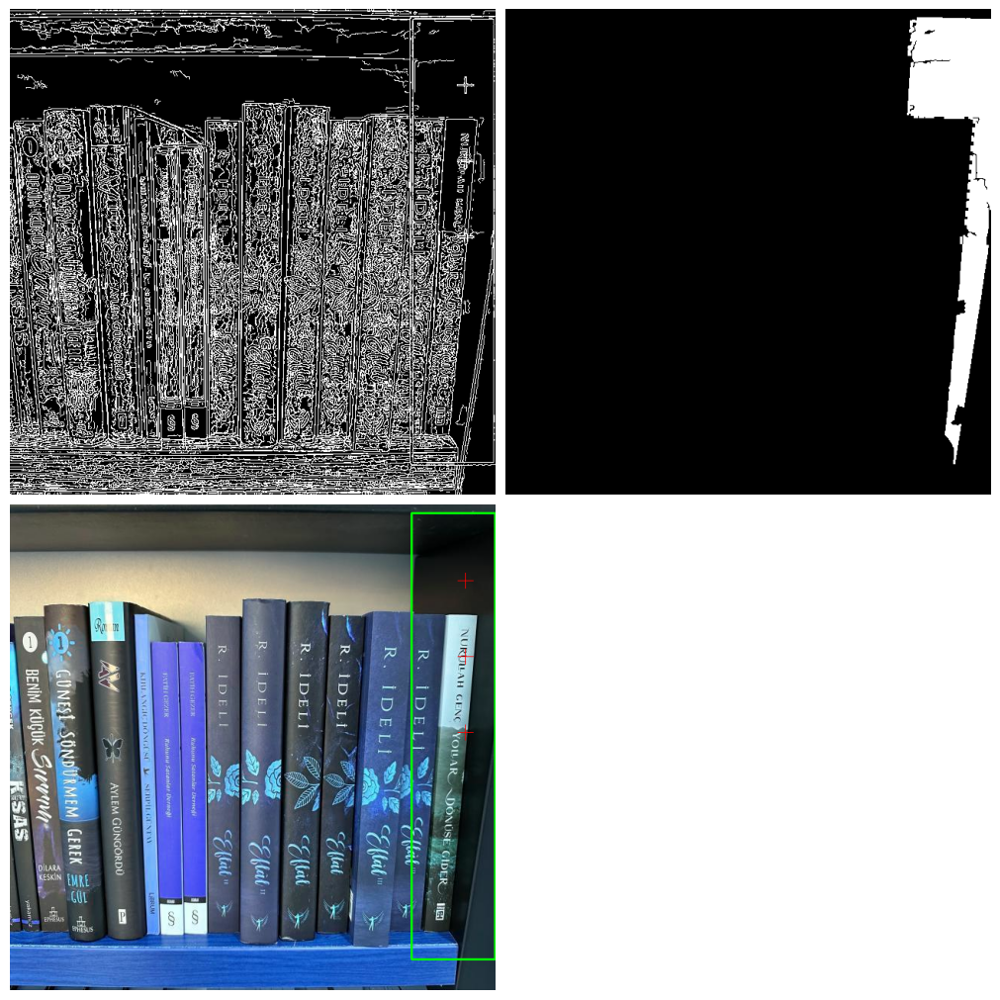

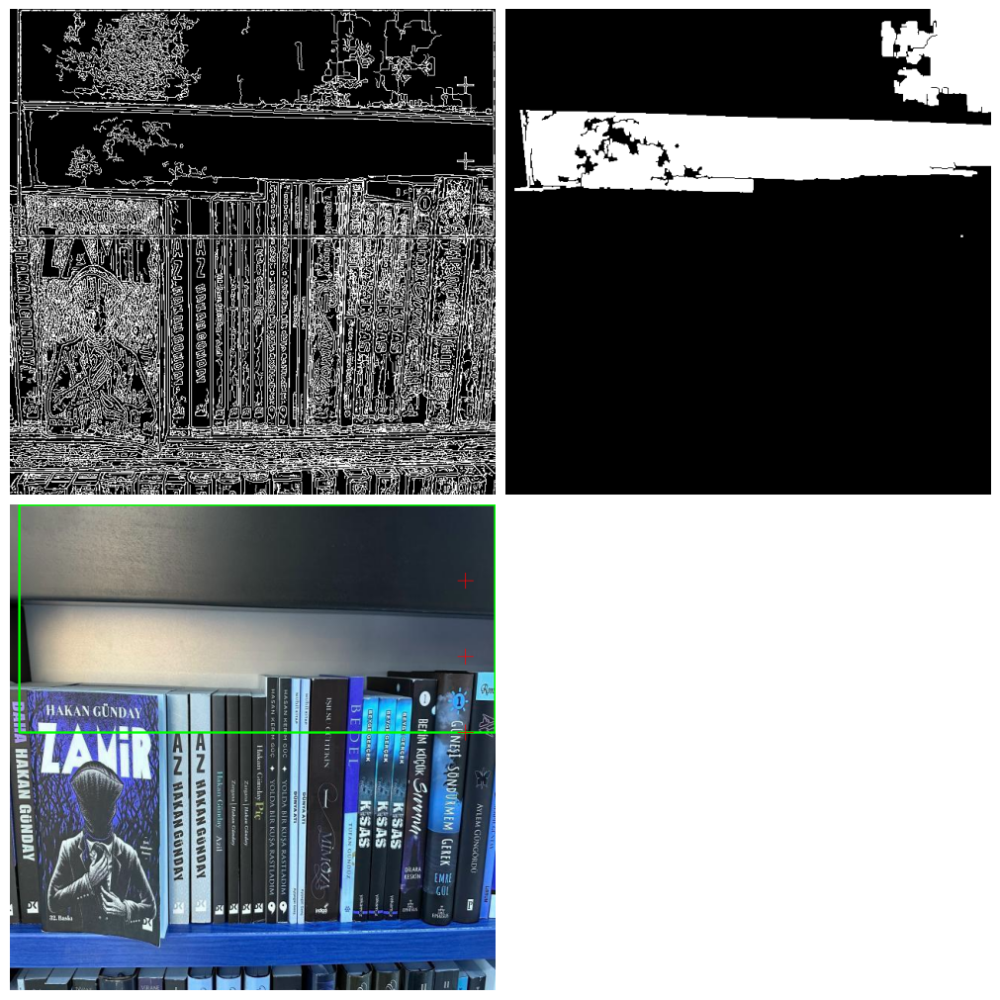

In [405]:

# List of seed points (x, y)
points = [ (600, 100), (600, 200), (600, 300)]

for sc in scenes:

    # Get connected regions
    region = extract_connected_regions(expand_edges_scenes(edge_on_rgb(sc)), points)

    bbox, _ = get_min_area_bounding_box(region)

    final = cv2.drawContours(sc, [bbox], 0, (0, 255, 0), 2)
    for p in points:
        final = cv2.drawMarker(final, p, (255,0,0))
    display_image_grid([edge_on_rgb(sc), region, final])